# Dynamic Profile Forecasting by ENEDIS 

## Challenge goals
We would like to forecast 7 dynamic profile time-series, modelling the consumption shape of several mass-market customer groups (residential and small businesses with subscribed power up to 36 kVA) thanks to meteorological and calendar data, as well as any other real time dataset potentially correlated with consumption patterns. Those profiles are coefficients (without units) for each half-hour in the dataset.<br>

The dataset size depends on each specific profile (collected from Oct 13th, 2013 onwards for residential profiles and from Nov 1st, 2016 for commercial profiles). This challenge is about forecasting dynamic profiles values from their past values and all the components of Enedis’ Half hourly Electrical Balancing.<br>

The Testing period will be in the past, from July 1st, 2017 to June 30th, 2018.<br>

There are many possible explanatory variables since consumption patterns are linked to consumers’ behavior and economic activity. Weather conditions (cold spell / heat wave) and business holidays will impact energy consumption but some other factors may also contribute to modifying energy consumption. As an example, our RES1 profile is presented there, over a week period:<br>
In green: static series including business holidays. <br>
In blue: static series including business holidays and weather.<br> 
In red: dynamic series computed ex-post.

## Data description

Please be careful to the temporal alignment: For the same ID, there is a **one day delay** between data provided in the input files (that are measured or estimated for the date given in Horodate_UTC ) and the values of dynamic Profiles provided in the output files (representing customer behaviour for the date given in horodate). This delay allows to have a challenge closer to our operational needs: we will be able to get the data from the input files of the previous day to forecast the dynamic profiles.

Data in the time series are **hour beginning**: for example, a value at à 08h00 is the integrated value from 08h00 to 08h30 for the said data.<br>
Training files include data for the period [13/10/2013 - 12/10/2018] excluding the [01/07/2017 - 30/06/2018] period.<br>
Regarding the 3 commercial profiles, data only start on Nov 1st,2016. <br>
Testing files include data for the [01/07/2017 - 30/06/2018] period.<br>
Please note that we use the French date and time notation: dd/mm/YYYY HH:MM in the files.

### Time series description for the input files
* #### Weather Data
    **Température réalisée lissée (°Celcius)**: Average recorded temperature (°C)<br>
    **Température normale lissée (°Celcius)**: Average standard temperature (°C)<br>
    **Pseudo rayonnement**: Pseudo radiation (Linear combination of recorded data from 32 official weather stations<br>

* #### Measured Data
    *Electricity exchange with other networks* :<br>

    **Injection RTE (W)** : Average power (during the half hours) injected from RTE (transmission grid) (W)<br>
    **Refoulement RTE (W)** : Average power injected back into the transmission grid (W)<br>
    **Soutirage net vers autres GRD (W)** : Average power injected into local DSO networks (W)<br>

    *From Smart meters*:<br>

    **Consommation HTA télérelevée en courbe de charge (W)** : load curve-measured medium voltage (MV, i.e., 20 000 V in most areas) consumption (W)<br>
    **Production décentralisée télérelevée en courbe de charge (W)** : load curve-measured decentralized production (W)

* #### Modelled Data:
    **Pertes modélisées (W)**: Losses Model based on a second order polynomial, recalibrated every year. (Based on RTE gross injection until July 1st, 2018, and on net RTE injection (Power injected – Power injected back to transmission grid), net Power injected into local independent DSOs and decentralized production since that date.<br>
    **Consommation totale profilée (W)**: Total modelled consumption (W)<br>
    **Consommation HTA profilée (W)**: MV modelled consumption (W)<br>
    **Consommation PME-PMI profilée (W)**: SMEs and SMIs modelled consumption (W)<br>
    **Consommation professionnelle profilée (W)**: Small businesses modelled consumption (W)<br>
    **Consommation résidentielle profilée (W)**: Households modelled consumption (W)<br>
    **Production décentralisée profilée (W)**: Total modelled decentralized production (W)<br>
    **Production photovoltaïque profilée (W)**: Photovoltaic modelled production (W)<br>
    **Production autre profilée (W)**: Other modelled decentralized production (W) Modelling of customer consumption through static profiling until July 1st, 2018. Since then the modelling technique has changed for 7 consumption sub profiles, from static to dynamic modelling based on real measurements.<br>

* #### Sums (from Models and Measurements):
    **Consommations totale (W)**: Total consumption (W)<br>
    **Production décentralisée totale (W)**: Total decentralized production (W)<br>
    **Production éolienne totale (W)**: Total wind production (W)<br>
    **Production photovoltaïque totale (W)**: Total Photovoltaic production (W)<br>
    **Consommation HTA totale (W)**: total MV consumption (W)<br>

### Time Series description for the Output Files
   **RES1_BASE**: Residential customer profile, subscribed power up to 6kVA, with no tariff option <br>
   **RES11_BASE**: Residential customer profile, subscribed power over 6kVA, with no tariff option<br>
   **RES2_HP**: Residential customer profile, with Peak Hours/Off Peak Hours tariff option, during Peak hours.<br>
   **RES2_HC**: Residential customer profile, with Peak Hours/Off Peak Hours tariff option, during Off Peak hours.<br>
   **PRO1_BASE**: Commercial customer profile, with no tariff option<br>
   **PRO2_HP**: Commercial customer profile, with Peak Hours/Off Peak Hours tariff option, during Peak hours.<br>
   **PRO2_HC**: Commercial customer profile, with Peak Hours/Off Peak Hours tariff option, during Off Peak hours.<br>

In [1]:
weather = ['Température réalisée lissée (°Celcius)','Température normale lissée (°Celcius)','Pseudo rayonnement']
measured = ['Injection RTE (W)', 'Refoulement RTE (W)','Soutirage net vers autres GRD (W)','Production décentralisée télérelevée à courbe de charge (W)','Consommation HTA télérelevée à courbe de charge (W)']
ex_measured = ['Injection RTE (W)', 'Refoulement RTE (W)','Soutirage net vers autres GRD (W)']
smart_measured = ['Production décentralisée télérelevée à courbe de charge (W)','Consommation HTA télérelevée à courbe de charge (W)']
modelled = ['Pertes modélisées (W)','Consommation totale profilée (W)','Consommation HTA profilée (W)','Consommation PME-PMI profilée (W)','Consommation professionnelle profilée (W)','Consommation résidentielle profilée (W)','Production décentralisée profilée (W)','Production photovoltaïque profilée (W)','Production autre profilée (W)']
sums = ['Consommations totale (W)','Production décentralisée totale (W)','Production éolienne totale (W)','Production photovoltaïque totale (W)','Consommation HTA totale (W)']
features = weather+measured+ex_measured+smart_measured+modelled+sums
targets = ['RES1_BASE', 'RES11_BASE', 'PRO1_BASE', 'RES2_HC', 'RES2_HP','PRO2_HC', 'PRO2_HP']

***

In [2]:
from IPython.core.interactiveshell import InteractiveShell 
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import missingno as msno
from scipy.stats import norm
import os

In [3]:
nb_path = os.path.abspath(".")
InteractiveShell.ast_node_interactivity = "all"
sns.set(color_codes=True)
pd.set_option('display.max_columns', 33)

# 1. Exploratory Data Analysis
## Summary

## Variable Identification and Basic Analysis
- **Target Variable** : 'RES1_BASE', 'RES11_BASE', 'PRO1_BASE', 'RES2_HC', 'RES2_HP','PRO2_HC', 'PRO2_HP'
- **Dataset Size** : 70128 rows × 33 columns
- **Data Types** : qualitative: 0  , quantitative: 33
- **Missing & Zero Values** : 

*Input*:<br>
Pseudo rayonnement has 60244 (85.9%) missing values<br>
Production photovoltaïque profilée (W) has 30903 (44.1%) zeros<br>

*Output*:<br>
PRO1_BASE has 53474 (76.3%) missing values	<br>
PRO2_HC has 53474 (76.3%) missing values	<br>
PRO2_HP has 53474 (76.3%) missing values<br>
RES2_HC has 17689 (25.2%) zeros	<br>
RES2_HP has 720 (1.0%) zeros	<br>
PRO2_HC has 4203 (6.0%) zeros

*DateTime Variable*: <br>
training timeframe: 11/01/2013 - 12/10/2018 excluding the testing timeframe: 01/07/2017 - 30/06/2018<br>
Sampling frequency : 1 data point/ 30min

- **Variable signification**: 
télérelevé = plus grosse tension sur le réseau, donc plutot des PME, donne une idée d'activité, apprendre de ce comportement pour, et le décliner sur les catégories pro ou res.
Les 7 profils participent à la consommation profilée, mais on ne pourra pas en désagrégeant la conso totale retrouver les 7 profils car il ne sont pas seuls, les poids peuvent aussi varier par jour.

    
## Univariate Time Series Analysis

- **Visualisation of the Target** : imbalanced data as 99.1% is labeled "OK" (or 0) and 0.9% is labeled "KO" (or 1).
    
    
- **Visualisation of Variables** : not all normally distributed , not standardized, some variables are skewed, others are discrete.
   

## Bivariate Analysis

- **Variables / Target Relation** : no apparent difference in distribution betweeen "KO" and "OK" labeled variables. There are also no outliers in any of the "KO" labeled varaibles.
   

- **Variables / Variables Relation** : variables from the same machine tend have a higher correlation degree.
    

## Hypothesis Tests 
    

***

## Variable Identification and Basic Analysis

### Loading Data

In [237]:
trainset_in =pd.read_csv(os.path.join(nb_path,"training_input_qFI2jug.csv"))
trainset_out = pd.read_csv(os.path.join(nb_path,"training_output_uamzSZW.csv"))

In [280]:
# merging input and output trainset
trainset = trainset_in.merge(trainset_out, on=['IDS','Horodate_UTC','Horodate']).drop('Horodate', axis=1)
trainset['Horodate_UTC'] = trainset['Horodate_UTC'].apply(pd.to_datetime, format="%d/%m/%Y %H:%M") #parsing according to the French datetime format
trainset = trainset.set_index('Horodate_UTC')

In [281]:
trainset.head()

,IDS,Mois_x,Injection RTE (W),Refoulement RTE (W),Pertes modélisées (W),Consommations totale (W),Consommation HTA télérelevée à courbe de charge (W),Consommation totale profilée (W),Consommation HTA profilée (W),Consommation PME-PMI profilée (W),Consommation professionnelle profilée (W),Consommation résidentielle profilée (W),Production décentralisée totale (W),Production décentralisée télérelevée à courbe de charge (W),Production décentralisée profilée (W),Production photovoltaïque profilée (W),Production autre profilée (W),Température réalisée lissée (°Celcius),Température normale lissée (°Celcius),Production éolienne totale (W),Production photovoltaïque totale (W),Pseudo rayonnement,Consommation HTA totale (W),Soutirage net vers autres GRD (W),Mois_y,RES1_BASE,RES11_BASE,PRO1_BASE,RES2_HC,RES2_HP,PRO2_HC,PRO2_HP
Horodate_UTC,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2013-10-13 22:00:00,1,10,39784230000,103415000,2849582877,37576289504,8062590100,29513699404,1009515939,2924365887,4819516366,20760301211,1181480681,1169604460,11876221,0.0,608873.0,9.6,13.5,302936853.0,19660.0,NaN,9072106039,436423300,10,0.791405,0.698925,NaN,2.780413,0.346364,NaN,NaN
2013-10-13 22:30:00,2,10,37114681000,119543000,2603906116,35230706411,8023402840,27207303571,1007708541,2881297990,4765108695,18553188344,1247399186,1235680180,11719006,0.0,608873.0,9.6,13.5,368725682.0,17004.0,NaN,9031111381,407924660,10,0.693700,0.722778,NaN,2.301527,0.375439,NaN,NaN
2013-10-13 23:00:00,3,10,36148675000,136447000,2516689035,34428316838,7982839990,26445476848,966660739,2790724292,4500901592,18187190226,1331017863,1319275090,11742773,0.0,608873.0,9.6,13.5,448572685.0,24299.0,NaN,8949500729,398239990,10,0.648565,0.678717,NaN,2.361320,0.268125,NaN,NaN
2013-10-13 23:30:00,4,10,35488831000,164083000,2457628530,33922151279,7953531370,25968619909,929311479,2653092678,4308193617,18078022135,1435603490,1423884480,11719010,0.0,608873.0,9.5,13.5,550243295.0,23308.0,NaN,8882842849,380571680,10,0.621059,0.668509,NaN,2.567490,0.192953,NaN,NaN
2013-10-14 00:00:00,5,10,34882911000,191859000,2403762298,33447730318,7922448360,25525281958,907509517,2641317515,4166651481,17809803445,1527593647,1515861840,11731807,0.0,608873.0,9.5,13.5,644783673.0,21963.0,NaN,8829957877,367153030,10,0.612245,0.700487,NaN,2.563460,0.075701,NaN,NaN


### Missing and Zero Values

In [203]:
import missingno as msno

<AxesSubplot:>

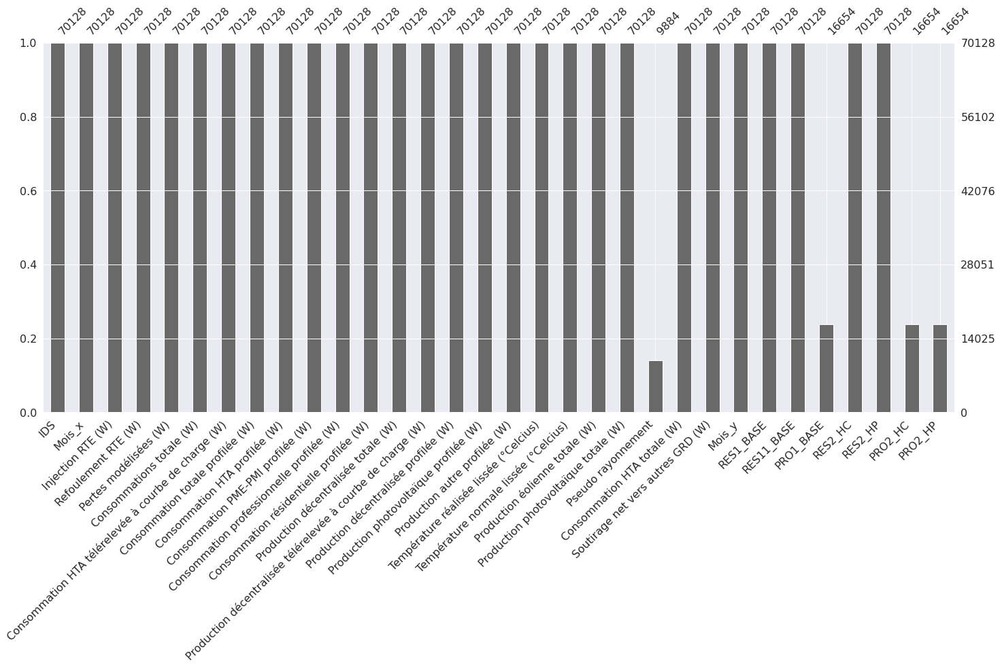

In [282]:
msno.bar(trainset)

<AxesSubplot:>

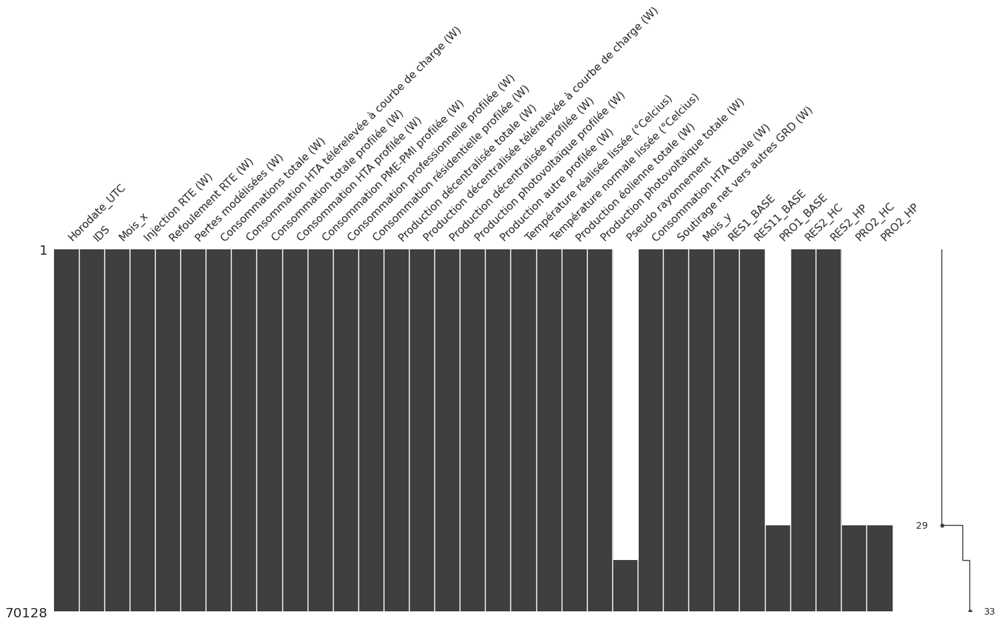

In [283]:
msno.matrix(trainset.reset_index())

In [312]:
(trainset.index[1:]-trainset.index[:-1]).value_counts()

0 days 00:30:00      70126
365 days 00:30:00        1
Name: Horodate_UTC, dtype: int64

## Univariate Analysis

In [315]:
import plotly.express as px

### Weather Variables

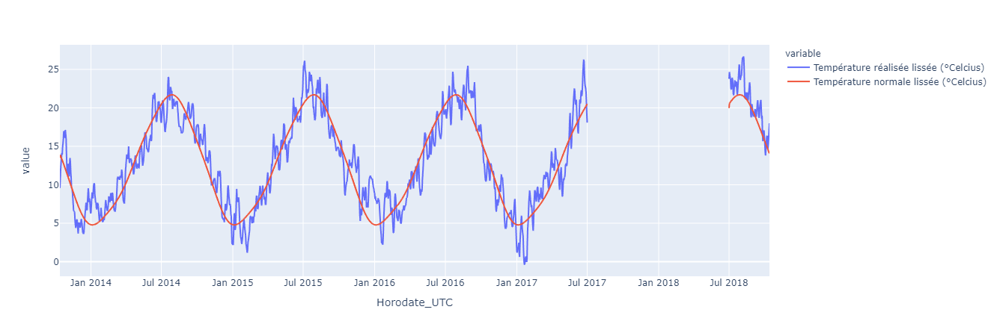

In [326]:
px.line(trainset[weather[:-1]].resample('d').mean())

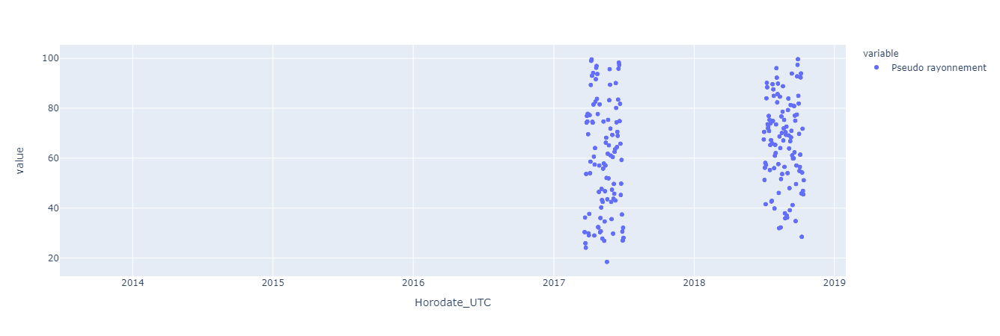

In [323]:
px.scatter(trainset[weather[-1]].resample('d').mean())

### Measured Variables

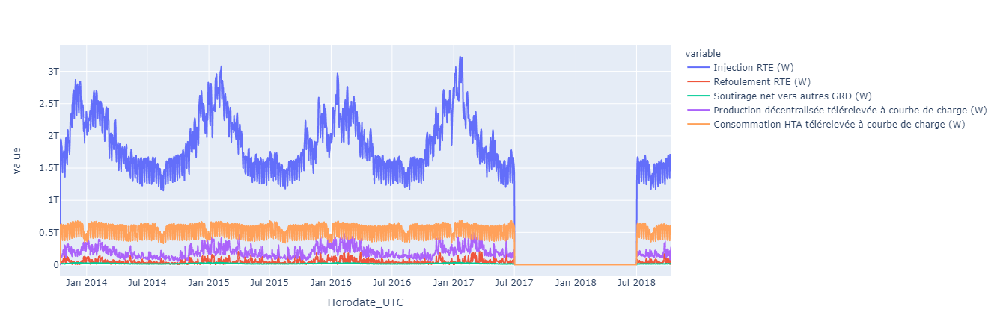

In [339]:
px.line(trainset[measured].resample('d').sum())

### Modelled Variables

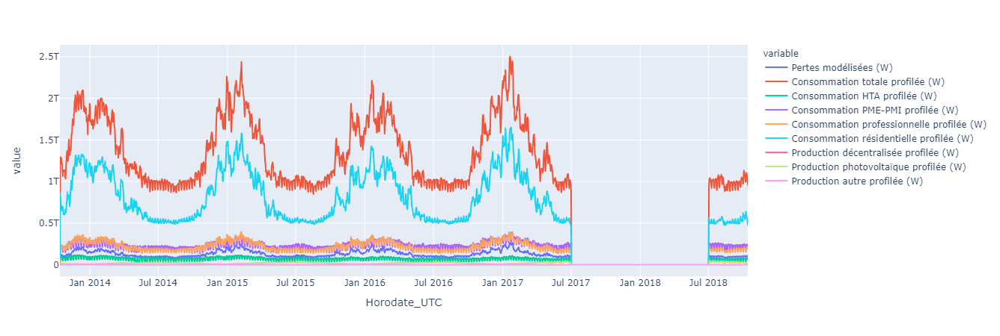

In [340]:
px.line(trainset[modelled].resample('d').sum())

### Sums Variables

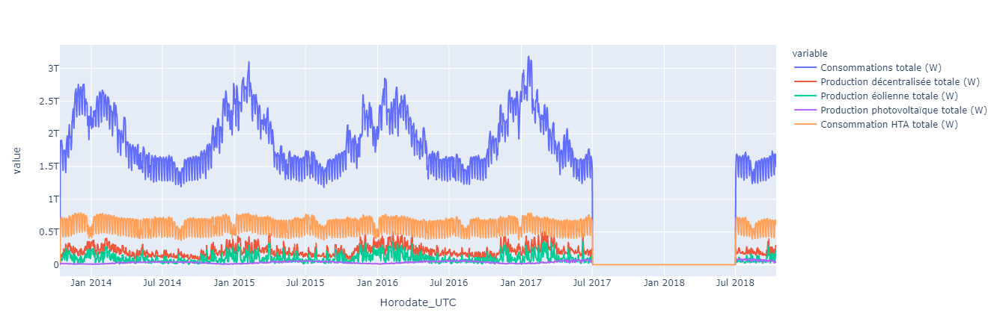

In [341]:
px.line(trainset[sums].resample('d').sum())

### Targets

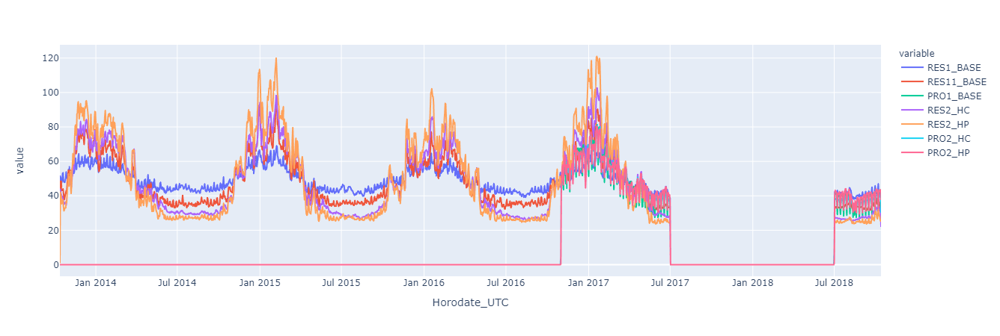

In [343]:
px.line(trainset[targets].resample('d').sum())

### Stationnarity Test of Targets

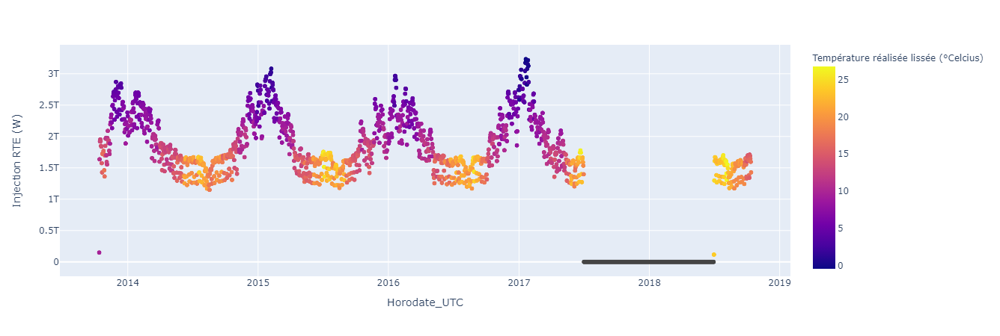

In [291]:
px.scatter(trainset.resample('d').agg({measured[0]: np.sum, weather[0]: np.mean}), y=measured[0], color=weather[0])

### Facebook Prophet

Requirements: date column need to be "ds", outcome "y"
NB: best works for daily forecast


#plot individual component of forecast: trend, weekluy/yearly seasonality
m.plot_component(forecast)

#can add holidays as arg in Prophet model for a better performance, also with spillover

#model.make_future_dataframe(periods=365, freq="30M", include_history=True) 

#can add a cap to limit theorethical growth: add column in the dataframe d['cap']=some_number
#can also add growing function as argument in model, ex: logistic

In [ ]:
(trainset.resample('w').agg({measured[0]: np.sum, weather[0]: np.mean})

In [286]:
pd.set_option('display.max_rows', 30)

In [ ]:
import statsmodels.api as sm
# multiplicative
res = sm.tsa.seasonal_decompose(ts.values,freq=12,model="multiplicative")
#plt.figure(figsize=(16,12))
fig = res.plot()
#fig.show()

In [152]:
df = trainset_in
df['Horodate_UTC'] = df['Horodate_UTC'].apply(pd.to_datetime)
df = df.set_index('Horodate_UTC')

In [163]:
df.index
df.sort_index().index

DatetimeIndex(['2013-10-13 22:00:00', '2013-10-13 22:30:00',
               '2013-10-13 23:00:00', '2013-10-13 23:30:00',
               '2013-10-14 00:00:00', '2013-10-14 00:30:00',
               '2013-10-14 01:00:00', '2013-10-14 01:30:00',
               '2013-10-14 02:00:00', '2013-10-14 02:30:00',
               ...
               '2018-10-13 17:00:00', '2018-10-13 17:30:00',
               '2018-10-13 18:00:00', '2018-10-13 18:30:00',
               '2018-10-13 19:00:00', '2018-10-13 19:30:00',
               '2018-10-13 20:00:00', '2018-10-13 20:30:00',
               '2018-10-13 21:00:00', '2018-10-13 21:30:00'],
              dtype='datetime64[ns]', name='Horodate_UTC', length=70128, freq=None)

DatetimeIndex(['2013-01-11 00:00:00', '2013-01-11 00:30:00',
               '2013-01-11 01:00:00', '2013-01-11 01:30:00',
               '2013-01-11 02:00:00', '2013-01-11 02:30:00',
               '2013-01-11 03:00:00', '2013-01-11 03:30:00',
               '2013-01-11 04:00:00', '2013-01-11 04:30:00',
               ...
               '2018-12-10 19:00:00', '2018-12-10 19:30:00',
               '2018-12-10 20:00:00', '2018-12-10 20:30:00',
               '2018-12-10 21:00:00', '2018-12-10 21:30:00',
               '2018-12-10 22:00:00', '2018-12-10 22:30:00',
               '2018-12-10 23:00:00', '2018-12-10 23:30:00'],
              dtype='datetime64[ns]', name='Horodate_UTC', length=70128, freq=None)

In [164]:
(df.sort_index().index[1:]-df.sort_index().index[:-1]).value_counts()

0 days 00:30:00     70088
6 days 00:30:00         8
29 days 00:30:00        5
26 days 00:30:00        4
2 days 00:30:00         4
24 days 00:30:00        3
27 days 00:30:00        3
25 days 00:30:00        3
28 days 00:30:00        3
10 days 00:30:00        2
31 days 22:30:00        1
5 days 02:30:00         1
0 days 22:30:00         1
24 days 02:30:00        1
Name: Horodate_UTC, dtype: int64

In [173]:
dff = trainset_out
dff['Horodate_UTC'] = dff['Horodate_UTC'].apply(pd.to_datetime)
dff = dff.set_index('Horodate_UTC')
dff.index
dff.sort_index().index
(dff.sort_index().index[1:]-dff.sort_index().index[:-1]).value_counts()

DatetimeIndex(['2013-10-13 22:00:00', '2013-10-13 22:30:00',
               '2013-10-13 23:00:00', '2013-10-13 23:30:00',
               '2013-10-14 00:00:00', '2013-10-14 00:30:00',
               '2013-10-14 01:00:00', '2013-10-14 01:30:00',
               '2013-10-14 02:00:00', '2013-10-14 02:30:00',
               ...
               '2018-10-13 17:00:00', '2018-10-13 17:30:00',
               '2018-10-13 18:00:00', '2018-10-13 18:30:00',
               '2018-10-13 19:00:00', '2018-10-13 19:30:00',
               '2018-10-13 20:00:00', '2018-10-13 20:30:00',
               '2018-10-13 21:00:00', '2018-10-13 21:30:00'],
              dtype='datetime64[ns]', name='Horodate_UTC', length=70128, freq=None)

DatetimeIndex(['2013-01-11 00:00:00', '2013-01-11 00:30:00',
               '2013-01-11 01:00:00', '2013-01-11 01:30:00',
               '2013-01-11 02:00:00', '2013-01-11 02:30:00',
               '2013-01-11 03:00:00', '2013-01-11 03:30:00',
               '2013-01-11 04:00:00', '2013-01-11 04:30:00',
               ...
               '2018-12-10 19:00:00', '2018-12-10 19:30:00',
               '2018-12-10 20:00:00', '2018-12-10 20:30:00',
               '2018-12-10 21:00:00', '2018-12-10 21:30:00',
               '2018-12-10 22:00:00', '2018-12-10 22:30:00',
               '2018-12-10 23:00:00', '2018-12-10 23:30:00'],
              dtype='datetime64[ns]', name='Horodate_UTC', length=70128, freq=None)

0 days 00:30:00     70088
6 days 00:30:00         8
29 days 00:30:00        5
26 days 00:30:00        4
2 days 00:30:00         4
24 days 00:30:00        3
27 days 00:30:00        3
25 days 00:30:00        3
28 days 00:30:00        3
10 days 00:30:00        2
31 days 22:30:00        1
5 days 02:30:00         1
0 days 22:30:00         1
24 days 02:30:00        1
Name: Horodate_UTC, dtype: int64

In [225]:
(trainset.sort_index().index[-1]-trainset.sort_index().index[0]).total_seconds()/60/30

103679.0

In [228]:
trainset.IDS

Horodate_UTC
2013-10-13 22:00:00        1
2013-10-13 22:30:00        2
2013-10-13 23:00:00        3
2013-10-13 23:30:00        4
2013-10-14 00:00:00        5
                       ...  
2018-10-13 19:30:00    87644
2018-10-13 20:00:00    87645
2018-10-13 20:30:00    87646
2018-10-13 21:00:00    87647
2018-10-13 21:30:00    87648
Name: IDS, Length: 70128, dtype: int64

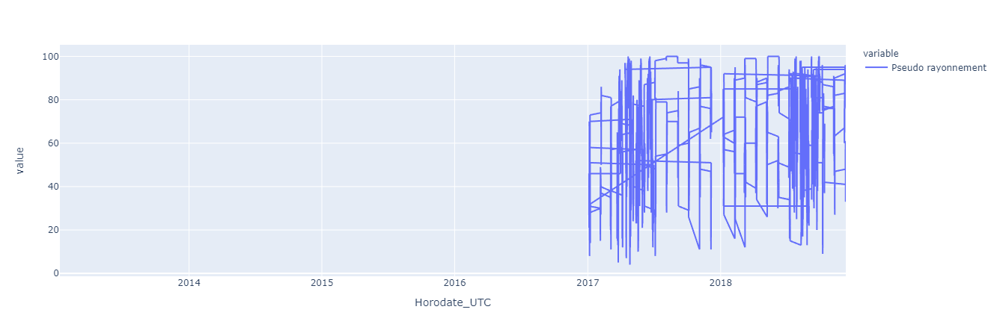

In [236]:
px.line(trainset['Pseudo rayonnement'])

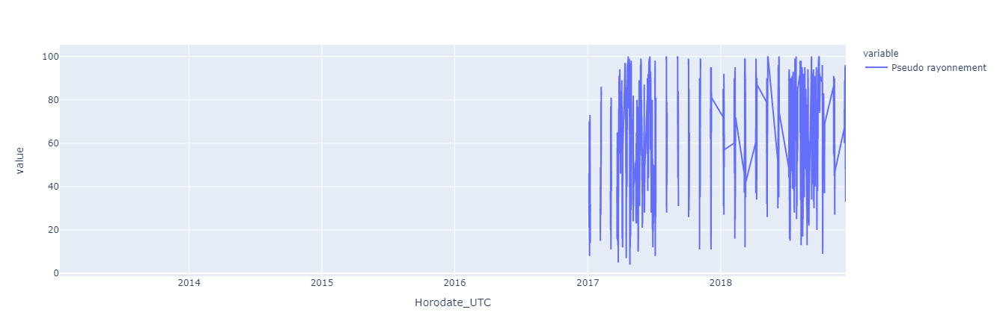

In [235]:
px.line(trainset['Pseudo rayonnement'].sort_index())

In [160]:
(df.index[1:]-df.index[:-1]).value_counts()

0 days 00:30:00        69510
30 days 00:30:00         288
29 days 00:30:00         192
27 days 00:30:00          36
28 days 00:30:00          12
-323 days +00:30:00        6
-236 days +00:30:00        5
-88 days +00:30:00         5
-118 days +00:30:00        4
-29 days +00:30:00         4
-148 days +00:30:00        4
-30 days +00:30:00         4
-207 days +00:30:00        4
-294 days +00:30:00        4
-266 days +00:30:00        4
-177 days +00:30:00        4
-59 days +00:30:00         4
-293 days +00:30:00        3
-116 days +00:30:00        3
-175 days +00:30:00        3
-57 days +00:30:00         3
-87 days +00:30:00         3
-235 days +00:30:00        3
-264 days +00:30:00        3
-146 days +00:30:00        3
-205 days +00:30:00        3
-324 days +00:30:00        2
-176 days +00:30:00        1
-295 days +00:30:00        1
-58 days +00:30:00         1
365 days 00:30:00          1
-206 days +00:30:00        1
-117 days +00:30:00        1
-147 days +00:30:00        1
-265 days +00:

In [140]:
trainset[measured[0]].resample('30min').sum()
trainset[measured[0]]

Horodate_UTC
2013-01-11 00:00:00    37256445000
2013-01-11 00:30:00    36835920000
2013-01-11 01:00:00    36548137000
2013-01-11 01:30:00    35020256000
2013-01-11 02:00:00    33932359000
                          ...     
2018-12-10 21:30:00    34104811000
2018-12-10 22:00:00    32398086000
2018-12-10 22:30:00    29679983000
2018-12-10 23:00:00    28775402000
2018-12-10 23:30:00    28272235000
Freq: 30T, Name: Injection RTE (W), Length: 103680, dtype: int64

Horodate_UTC
2013-10-13 22:00:00    39784230000
2013-10-13 22:30:00    37114681000
2013-10-13 23:00:00    36148675000
2013-10-13 23:30:00    35488831000
2013-10-14 00:00:00    34882911000
                          ...     
2018-10-13 19:30:00    31579849000
2018-10-13 20:00:00    31343255000
2018-10-13 20:30:00    33724718000
2018-10-13 21:00:00    33587792000
2018-10-13 21:30:00    33178674000
Name: Injection RTE (W), Length: 70128, dtype: int64

In [147]:
(trainset.index[1:]-trainset.index[:-1]).value_counts()

0 days 00:30:00        69510
30 days 00:30:00         288
29 days 00:30:00         192
27 days 00:30:00          36
28 days 00:30:00          12
-323 days +00:30:00        6
-236 days +00:30:00        5
-88 days +00:30:00         5
-118 days +00:30:00        4
-29 days +00:30:00         4
-148 days +00:30:00        4
-30 days +00:30:00         4
-207 days +00:30:00        4
-294 days +00:30:00        4
-266 days +00:30:00        4
-177 days +00:30:00        4
-59 days +00:30:00         4
-293 days +00:30:00        3
-116 days +00:30:00        3
-175 days +00:30:00        3
-57 days +00:30:00         3
-87 days +00:30:00         3
-235 days +00:30:00        3
-264 days +00:30:00        3
-146 days +00:30:00        3
-205 days +00:30:00        3
-324 days +00:30:00        2
-176 days +00:30:00        1
-295 days +00:30:00        1
-58 days +00:30:00         1
365 days 00:30:00          1
-206 days +00:30:00        1
-117 days +00:30:00        1
-147 days +00:30:00        1
-265 days +00:

In [193]:
trainset['abc']=1

In [194]:
targets

['RES1_BASE',
 'RES11_BASE',
 'PRO1_BASE',
 'RES2_HC',
 'RES2_HP',
 'PRO2_HC',
 'PRO2_HP']

In [198]:
['abc',targets[-1]]

['abc', 'PRO2_HP']

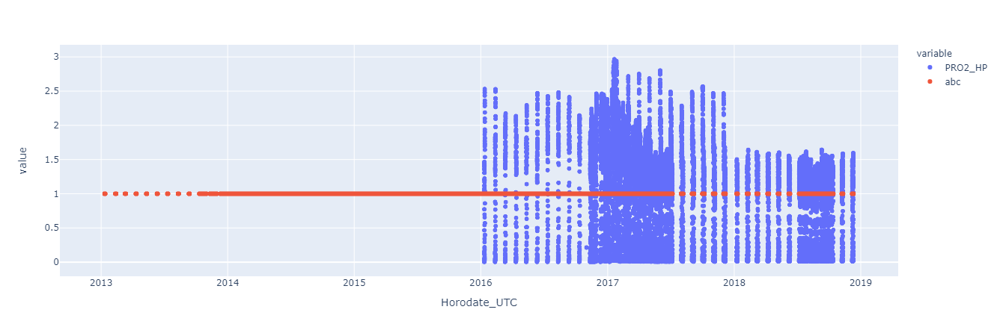

In [200]:
px.scatter(trainset, y=[targets[-1],'abc'])

In [181]:
df.sort_index()

,IDS,Horodate,Mois,Injection RTE (W),Refoulement RTE (W),Pertes modélisées (W),Consommations totale (W),Consommation HTA télérelevée à courbe de charge (W),Consommation totale profilée (W),Consommation HTA profilée (W),Consommation PME-PMI profilée (W),Consommation professionnelle profilée (W),Consommation résidentielle profilée (W),Production décentralisée totale (W),Production décentralisée télérelevée à courbe de charge (W),Production décentralisée profilée (W),Production photovoltaïque profilée (W),Production autre profilée (W),Température réalisée lissée (°Celcius),Température normale lissée (°Celcius),Production éolienne totale (W),Production photovoltaïque totale (W),Pseudo rayonnement,Consommation HTA totale (W),Soutirage net vers autres GRD (W)
Horodate_UTC,,,,,,,,,,,,,,,,,,,,,,,,,
2013-01-11 00:00:00,869,2013-10-31T01:00:00+01:00,10,37256445000,505269000,2255481644,36992801481,10673568220,26319233261,1666294001,3076286388,4538487911,17038164961,2897246396,2880594440,16651956,0.0,608474.0,10.8,11.0,1.786252e+09,22064.0,NaN,12339862221,400139270
2013-01-11 00:30:00,870,2013-10-31T01:30:00+01:00,10,36835920000,528342000,2222571744,36625338851,10637002600,25988336251,1604185283,2937484236,4378161748,17068504983,2922941595,2906339860,16601735,0.0,608474.0,10.8,11.0,1.806921e+09,22404.0,NaN,12241187883,382609000
2013-01-11 01:00:00,871,2013-10-31T02:00:00+01:00,10,36548137000,519895000,2200207485,36335642587,10624685820,25710956767,1590830984,2907064396,4263051017,16950010370,2883740382,2867418450,16321932,0.0,608474.0,10.8,11.0,1.766586e+09,22063.0,NaN,12215516804,376132310
2013-01-11 01:30:00,872,2013-10-31T02:30:00+01:00,10,35020256000,564324000,2083614206,34912236944,10622253950,24289982994,1610755725,2948907555,4187793585,15542526129,2896210430,2879888480,16321950,0.0,608474.0,10.7,10.9,1.786185e+09,19711.0,NaN,12233009675,356291280
2013-01-11 02:00:00,873,2013-10-31T03:00:00+01:00,10,33932359000,567605000,2002793327,33883999231,10645830200,23238169031,1622798455,2971466042,4188237932,14455666602,2870962238,2854690490,16271748,0.0,608474.0,10.7,10.9,1.772915e+09,23392.0,NaN,12268628655,348923680
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2018-12-10 21:30:00,87600,2018-10-11T23:30:00+02:00,10,34104811000,2220312000,2143639046,34885121098,10538578775,24346542323,1294949154,3177647331,3579441854,16294503983,5476147944,5463733667,12414277,0.0,3272696.0,16.8,13.7,4.637659e+09,24333.0,35.0,11833527929,331886800
2018-12-10 22:00:00,87601,2018-10-12T00:00:00+02:00,10,32398086000,1956476000,2030246969,33296122614,10433881205,22862241409,1246110816,3102820364,3529832481,14983477748,5200066716,5185635333,14431383,0.0,5006666.0,16.8,13.7,4.345488e+09,20786667.0,37.0,11679992021,315307133
2018-12-10 22:30:00,87602,2018-10-12T00:30:00+02:00,10,29679983000,1813296000,1852629970,30634378788,10366738209,20267640579,1252615134,3071287858,3441175930,12502561656,4915503908,4901195667,14308241,0.0,5006666.0,16.9,13.7,4.074450e+09,10222000.0,38.0,11619353343,295182150


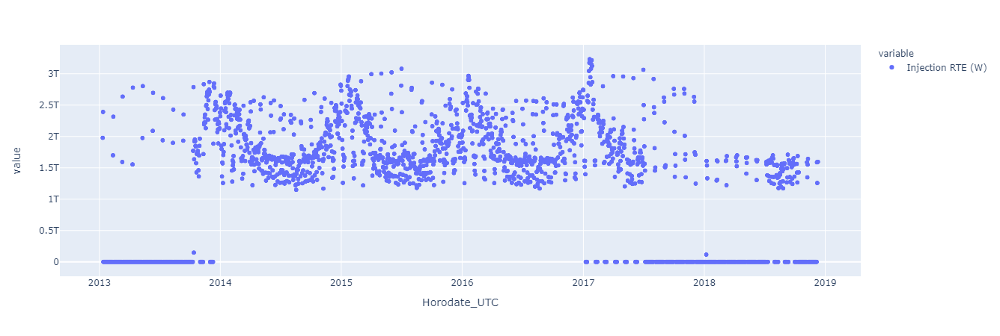

In [185]:
px.scatter(df.sort_index()[measured[0]].resample('1d').sum())

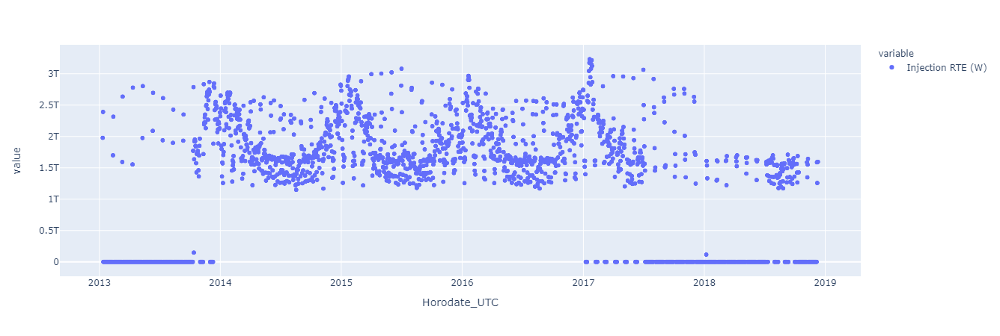

In [182]:
px.scatter(trainset[measured[0]].resample('1d').sum())

<Figure size 1440x360 with 0 Axes>

<AxesSubplot:xlabel='Horodate_UTC', ylabel='Pseudo rayonnement'>

<Figure size 1440x360 with 0 Axes>

<AxesSubplot:xlabel='Horodate_UTC', ylabel='RES1_BASE'>

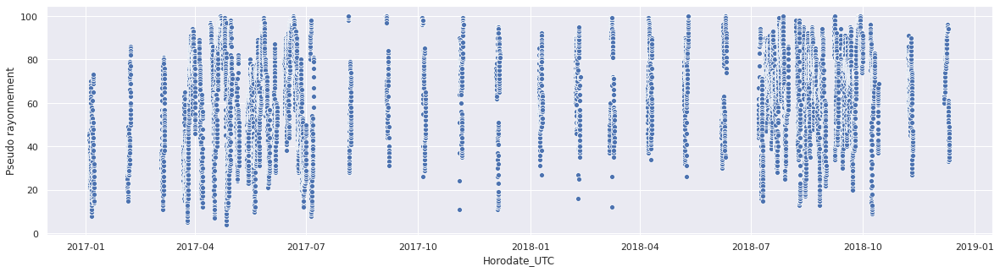

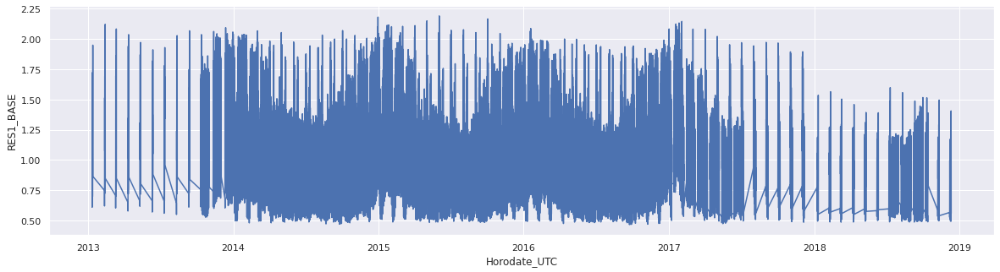

In [112]:
plt.figure(figsize=(20,5))
sns.scatterplot( x= trainset.index, y="Pseudo rayonnement", data=trainset, markers=True)
plt.figure(figsize=(20,5))
sns.lineplot( x= trainset.index, y=targets[0], data=trainset, markers=True)

In [10]:
from pandas_profiling import profile_report

In [109]:
trainset.profile_report(minimal=True)

### Variable Signification


In [2]:
import plotly.graph_objects as go
import cufflinks as cf